<a href="https://colab.research.google.com/github/Adith-Grokr/NewYorkCityAnalysis/blob/NYPD-Complaints/NYPD%20complaints.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [32]:
# Import libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
file_path = 'NYPD_Complaint_Map__Year_to_Date_.csv'
data = pd.read_csv(file_path)

# Display the first few rows
data.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,JURIS_DESC,...,PARKS_NM,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,Lat_Lon,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
0,287066200,123,STATEN ISLAND,05/17/2024,22:21:00,05/17/2024,22:25:00,COMPLETED,(null),N.Y. POLICE DEPT,...,(null),638.0,"HARASSMENT,SUBD 3,4,5",RESIDENCE-HOUSE,05/17/2024,POINT (-74.169591 40.545217),937116.0,137959.0,40.545217,-74.169591
1,287424426,121,STATEN ISLAND,05/24/2024,17:20:00,05/24/2024,17:25:00,COMPLETED,(null),N.Y. POLICE DEPT,...,(null),638.0,"HARASSMENT,SUBD 3,4,5",STREET,05/24/2024,POINT (-74.169067 40.582305),937288.0,151471.0,40.582305,-74.169067
2,290583574,121,STATEN ISLAND,06/05/2024,07:00:00,06/10/2024,07:00:00,COMPLETED,(null),N.Y. POLICE DEPT,...,(null),718.0,"FRAUD,UNCLASSIFIED-MISDEMEANOR",RESIDENCE-HOUSE,07/24/2024,POINT (-74.167396 40.638927),937791.0,172099.0,40.638927,-74.167396
3,289989348,121,STATEN ISLAND,07/12/2024,18:50:00,07/12/2024,19:05:00,COMPLETED,(null),N.Y. POLICE DEPT,...,(null),793.0,WEAPONS POSSESSION 3,STREET,07/12/2024,POINT (-74.163438 40.626851),938881.0,167697.0,40.626851,-74.163438
4,283856947,121,STATEN ISLAND,03/16/2024,19:45:00,03/16/2024,20:00:00,COMPLETED,(null),N.Y. POLICE DEPT,...,(null),109.0,"ASSAULT 2,1,UNCLASSIFIED",STREET,03/16/2024,POINT (-74.155867 40.631331),940986.0,169325.0,40.631331,-74.155867


In [33]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 433281 entries, 0 to 433280
Data columns (total 24 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   CMPLNT_NUM         433281 non-null  object 
 1   ADDR_PCT_CD        433281 non-null  int64  
 2   BORO_NM            433281 non-null  object 
 3   CMPLNT_FR_DT       433281 non-null  object 
 4   CMPLNT_FR_TM       433281 non-null  object 
 5   CMPLNT_TO_DT       410882 non-null  object 
 6   CMPLNT_TO_TM       433281 non-null  object 
 7   CRM_ATPT_CPTD_CD   433281 non-null  object 
 8   HADEVELOPT         433281 non-null  object 
 9   JURIS_DESC         433281 non-null  object 
 10  KY_CD              433281 non-null  int64  
 11  LAW_CAT_CD         433281 non-null  object 
 12  LOC_OF_OCCUR_DESC  433281 non-null  object 
 13  OFNS_DESC          433281 non-null  object 
 14  PARKS_NM           433281 non-null  object 
 15  PD_CD              433003 non-null  float64
 16  PD

In [34]:
# Convert date and time columns to datetime format for easier temporal analysis
data['CMPLNT_FR_DT'] = pd.to_datetime(data['CMPLNT_FR_DT'], errors='coerce')
data['CMPLNT_TO_DT'] = pd.to_datetime(data['CMPLNT_TO_DT'], errors='coerce')
data['CMPLNT_FR_TM'] = pd.to_datetime(data['CMPLNT_FR_TM'], format='%H:%M:%S', errors='coerce').dt.time
data['CMPLNT_TO_TM'] = pd.to_datetime(data['CMPLNT_TO_TM'], format='%H:%M:%S', errors='coerce').dt.time


In [35]:
# Check missing values across columns
missing_values = data.isnull().sum()

# Display the missing values
missing_values[missing_values > 0]


,0
CMPLNT_FR_DT,16
CMPLNT_TO_DT,22399
CMPLNT_TO_TM,22035
PD_CD,278
Lat_Lon,6
X_COORD_CD,6
Y_COORD_CD,6
Latitude,6
Longitude,6


In [36]:
# Drop rows with missing geographic coordinates
data.dropna(subset=['Latitude', 'Longitude'], inplace=True)

# Filling missing time data (CMPLNT_TO_TM) by approximating to the complaint start time
# If CMPLNT_TO_DT is missing, we can assume the incident ended the same day
data['CMPLNT_TO_DT'].fillna(data['CMPLNT_FR_DT'], inplace=True)
data['CMPLNT_TO_TM'].fillna(data['CMPLNT_FR_TM'], inplace=True)

# Drop any remaining missing values in date fields as we need them for temporal analysis
data.dropna(subset=['CMPLNT_FR_DT', 'CMPLNT_FR_TM'], inplace=True)

# Recheck missing values
missing_values_after = data.isnull().sum()

missing_values_after[missing_values_after > 0]


<ipython-input-36-14fd8a2f5523>:6: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-36-14fd8a2f5523>:7: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[

,0
PD_CD,272


In [37]:
data['PD_CD'].fillna(data['PD_CD'].mode()[0], inplace=True)

<ipython-input-37-a7073d8a23b1>:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





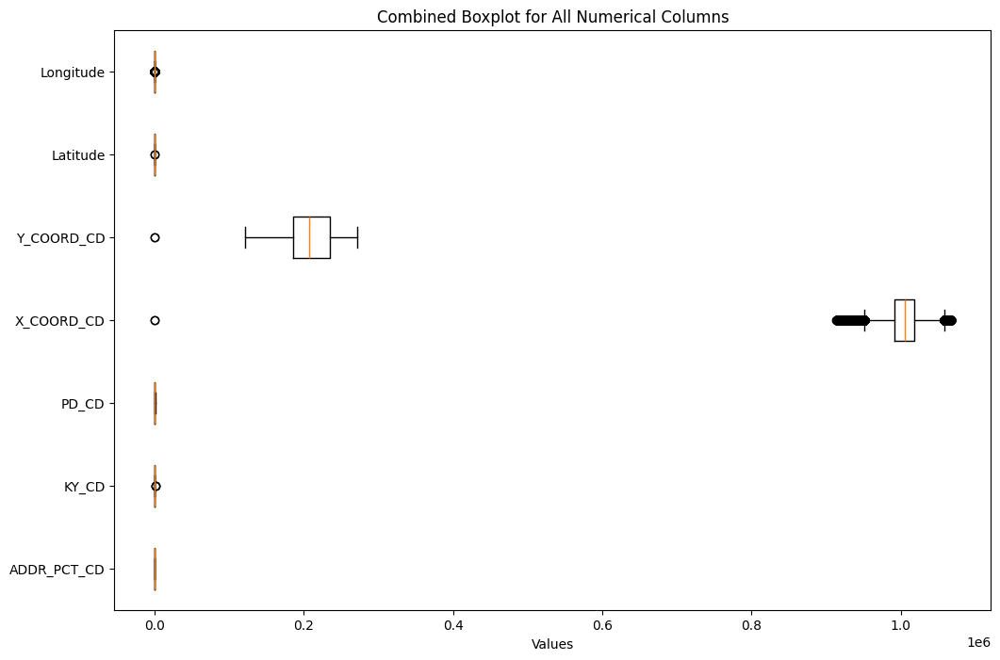

In [38]:
# Selecting only numerical columns for the combined boxplot
numerical_data = data.select_dtypes(include=['float64', 'int64'])

# Plotting combined boxplot
plt.figure(figsize=(12, 8))
plt.boxplot(numerical_data, vert=False, labels=numerical_data.columns)
plt.title("Combined Boxplot for All Numerical Columns")
plt.xlabel("Values")
plt.show()


In [39]:
# Function to apply IQR-based outlier capping
def cap_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df[column] = df[column].clip(lower=lower_bound, upper=upper_bound)

# Applying outlier capping to each relevant numerical column
for column in numerical_data:
    cap_outliers(data, column)

# Checking the capped columns to confirm outliers are handled
numerical_data.describe()


,ADDR_PCT_CD,KY_CD,PD_CD,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,433259.000000,433259.000000,433259.000000,4.332590e+05,433259.000000,433259.000000,433259.000000
mean,63.937931,301.148200,420.430401,1.005583e+06,207725.567813,40.736599,-73.922634
std,35.148740,158.017153,230.421032,2.154422e+04,29876.207040,0.119933,0.176641
min,1.000000,101.000000,100.000000,0.000000e+00,0.000000,0.000000,-74.254555
25%,40.000000,117.000000,258.000000,9.913670e+05,185568.000000,40.675980,-73.974334
50%,63.000000,341.000000,384.000000,1.005040e+06,207092.000000,40.735027,-73.924932
75%,102.000000,351.000000,638.000000,1.017983e+06,235058.000000,40.811838,-73.878203
max,123.000000,881.000000,969.000000,1.067306e+06,271819.000000,40.912714,0.000000


In [40]:
# Replacing "(null)" entries with NaN for proper handling
data['BORO_NM'].replace("(null)", pd.NA, inplace=True)
data['LOC_OF_OCCUR_DESC'].replace("(null)", pd.NA, inplace=True)

# Checking the number of nulls in these columns after replacement
null_counts_boro_loc = data[['BORO_NM', 'LOC_OF_OCCUR_DESC']].isnull().sum()
null_counts_boro_loc


<ipython-input-40-391308aefb00>:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-40-391308aefb00>:3: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[

,0
BORO_NM,476
LOC_OF_OCCUR_DESC,94955


In [41]:
# Filling missing values in `BORO_NM` with the most common value (mode)
data['BORO_NM'].fillna(data['BORO_NM'].mode()[0], inplace=True)

# Filling missing values in `LOC_OF_OCCUR_DESC` with "Not Specified"
data['LOC_OF_OCCUR_DESC'].fillna("Not Specified", inplace=True)

# Verifying that there are no missing values in these columns now
null_counts_after_fill = data[['BORO_NM', 'LOC_OF_OCCUR_DESC']].isnull().sum()
null_counts_after_fill


<ipython-input-41-8b3a7ce5bda5>:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-41-8b3a7ce5bda5>:5: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[

,0
BORO_NM,0
LOC_OF_OCCUR_DESC,0


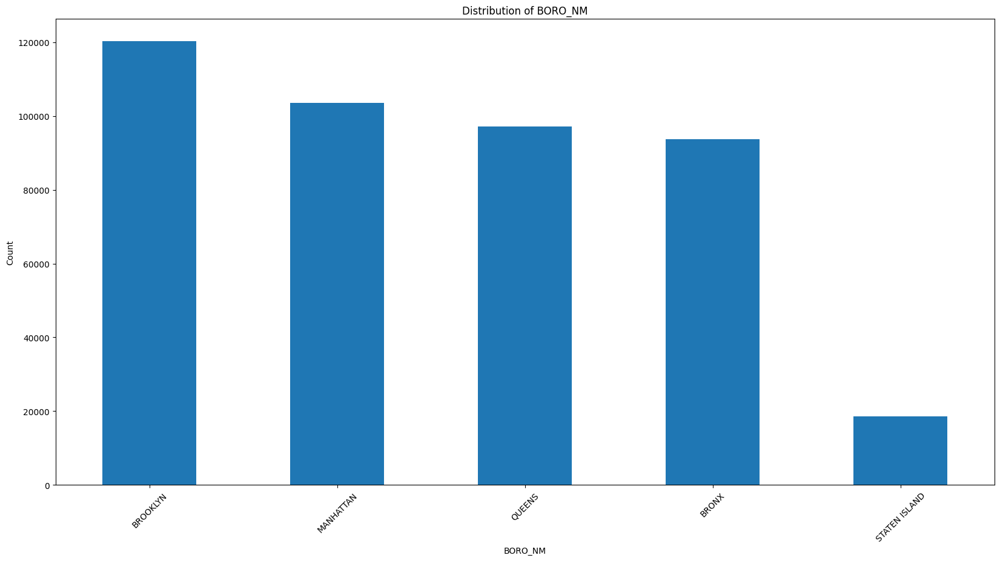

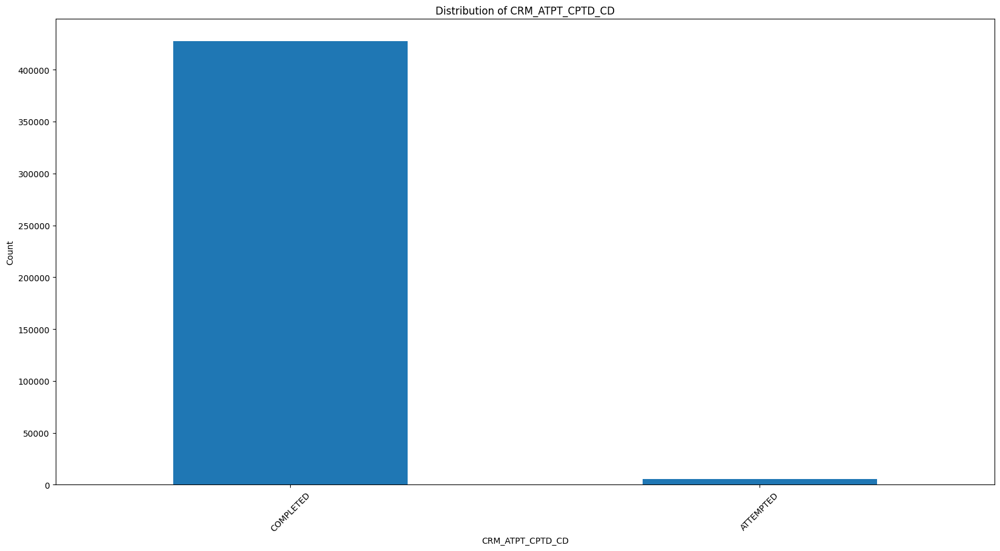

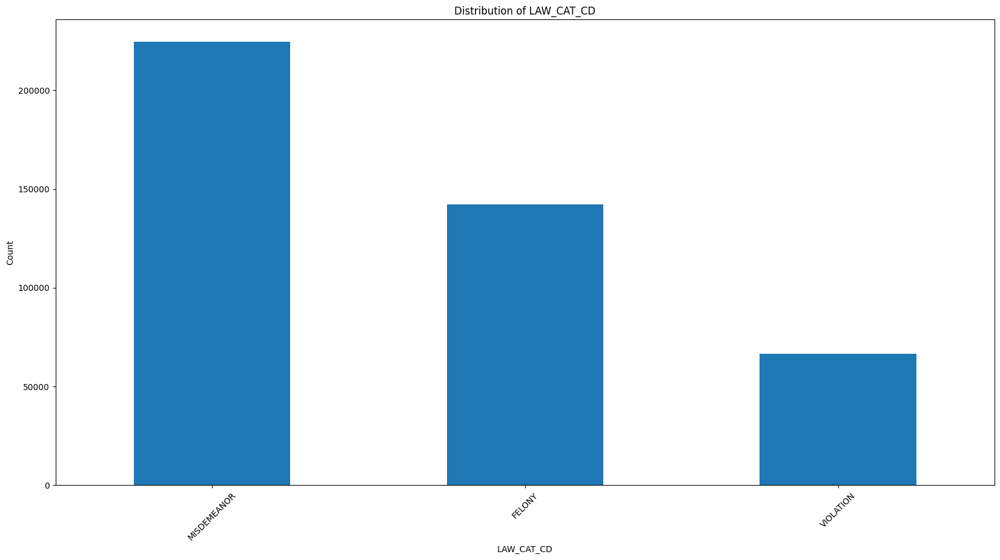

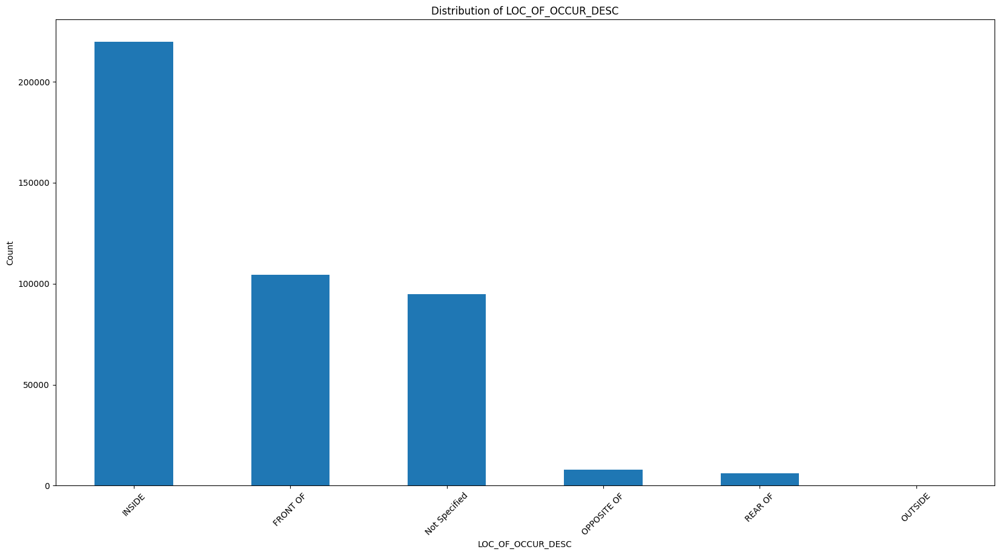

In [42]:
# Selecting categorical columns (descriptive columns) for visualization
categorical_columns = data.select_dtypes(include=['object']).columns

# Plotting bar charts for a few key descriptive columns to understand their distributions
# Limiting to columns with a reasonable number of unique values for readability

for column in categorical_columns:
    unique_values = data[column].nunique()
    if unique_values <= 15:  # Restricting to columns with fewer unique values for readability
        plt.figure(figsize=(20, 10))
        data[column].value_counts().plot(kind='bar')
        plt.title(f'Distribution of {column}')
        plt.xlabel(column)
        plt.ylabel('Count')
        plt.xticks(rotation=45)
        plt.show()


In [43]:
data.isnull().sum()

,0
CMPLNT_NUM,0
ADDR_PCT_CD,0
BORO_NM,0
CMPLNT_FR_DT,0
CMPLNT_FR_TM,0
CMPLNT_TO_DT,0
CMPLNT_TO_TM,0
CRM_ATPT_CPTD_CD,0
HADEVELOPT,0
JURIS_DESC,0


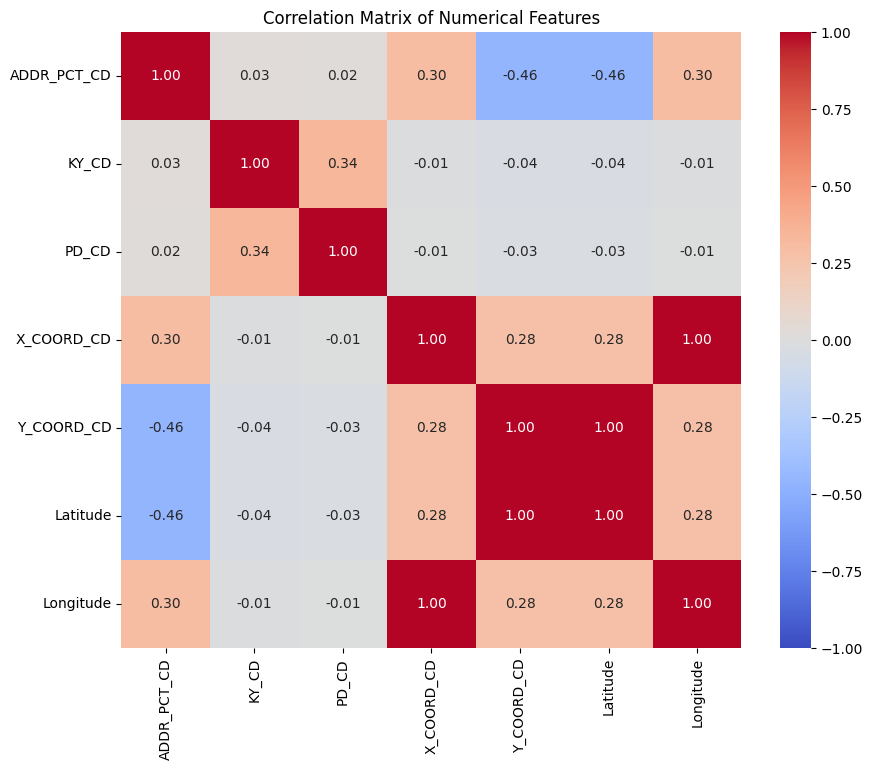

In [44]:
import seaborn as sns

# Calculating the correlation matrix for numerical columns
correlation_matrix = data.select_dtypes(include=['float64', 'int64']).corr()

# Plotting the heatmap for the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Matrix of Numerical Features")
plt.show()


In [14]:
# Plot the crime rates by incident type using Plotly.
import plotly.express as px
# Calculate the counts of each incident type
incident_type_counts = data['OFNS_DESC'].value_counts()

# Plot the crime rates by incident type
fig_incident_type = px.bar(incident_type_counts, x=incident_type_counts.index, y=incident_type_counts.values,
                           title='Crime Rates by Incident Type',
                           labels={'x': 'Incident Type', 'y': 'Crime Rate'})
fig_incident_type.update_xaxes(tickangle=45)
fig_incident_type.show()


In [15]:
# # Filter out rows with missing latitude or longitude
# data_map = data.dropna(subset=['Latitude', 'Longitude'])

# # Plotting crime hotspots on a map of NYC
# fig_hotspots = px.scatter_mapbox(data_map, lat="Latitude", lon="Longitude",
#                                  hover_name="OFNS_DESC", hover_data=["BORO_NM", "LAW_CAT_CD"],
#                                  color_discrete_sequence=["red"], zoom=10, height=600,
#                                  title="NYC Crime Hotspots by Location")

# # Use an open-street map style
# fig_hotspots.update_layout(mapbox_style="open-street-map")
# fig_hotspots.show()


In [16]:
# Group by borough and count the number of incidents in each
borough_crime_counts = data['BORO_NM'].value_counts()

# Plotting the crime rates across boroughs
fig_borough_comparison = px.bar(borough_crime_counts,
                                x=borough_crime_counts.index,
                                y=borough_crime_counts.values,
                                title="Crime Rates Across NYC Boroughs",
                                labels={'x': 'Borough', 'y': 'Crime Rate'})
fig_borough_comparison.show()


In [17]:
import pandas as pd
incident_type_counts = data.groupby(['OFNS_DESC', 'LAW_CAT_CD']).size().reset_index(name='Crime Rate')

# Plot the crime rates by incident type with different colors for LAW_CAT_CD
fig_incident_type = px.bar(incident_type_counts, x='OFNS_DESC', y='Crime Rate', color='LAW_CAT_CD',
                           title='Crime Rates by Incident Type with Law Category',
                           labels={'OFNS_DESC': 'Incident Type', 'Crime Rate': 'Number of Incidents'},
                           height=600)
fig_incident_type.update_xaxes(tickangle=45)
fig_incident_type.show()


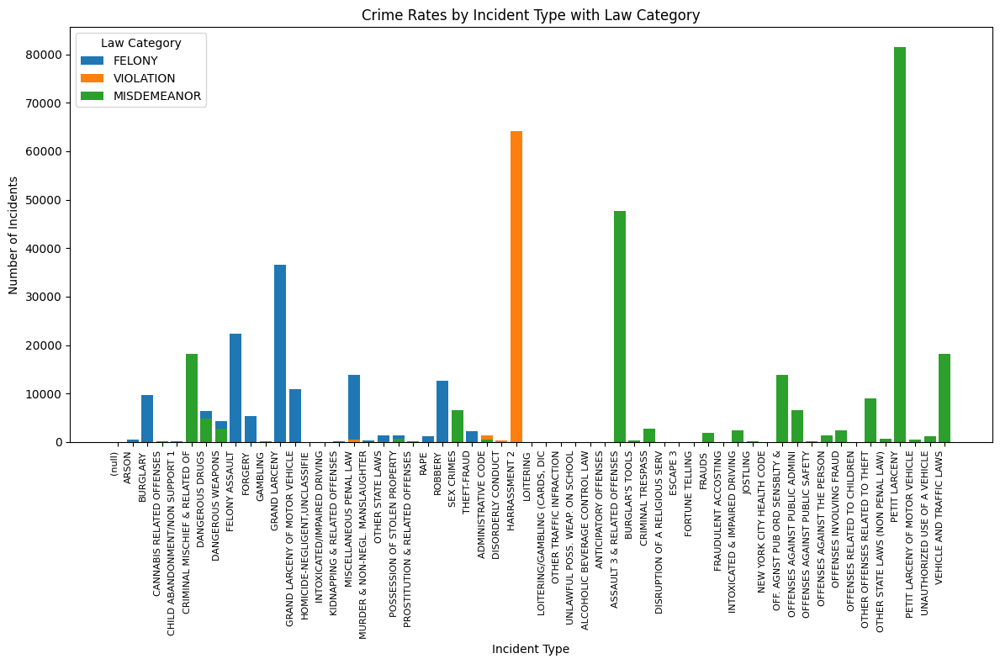

In [30]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'data' is already loaded with the NYPD dataset

# Group data by 'OFNS_DESC' and 'LAW_CAT_CD' to get counts by incident type and law category
incident_type_counts = data.groupby(['OFNS_DESC', 'LAW_CAT_CD']).size().reset_index(name='Crime Rate')

# Create a static bar plot for crime rates by incident type with different colors for LAW_CAT_CD
plt.figure(figsize=(12, 8))
for law_category in incident_type_counts['LAW_CAT_CD'].unique():
    subset = incident_type_counts[incident_type_counts['LAW_CAT_CD'] == law_category]
    plt.bar(subset['OFNS_DESC'], subset['Crime Rate'], label=law_category)

# Customize plot
plt.title('Crime Rates by Incident Type with Law Category')
plt.xlabel('Incident Type')
plt.ylabel('Number of Incidents')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.legend(title='Law Category')
plt.tight_layout()

# Display the plot
plt.show()


In [18]:
# Separate data by offense categories
offense_categories = data['LAW_CAT_CD'].unique()

# Generate and display a separate map for each law category
for offense_type in offense_categories:
    # Filter the data for the current law category (e.g., Felony, Misdemeanor, Violation)
    offense_data = data[data['LAW_CAT_CD'] == offense_type]

    # Plotting the hotspots for the current offense type on a map of NYC
    fig_offense_map = px.scatter_mapbox(offense_data, lat="Latitude", lon="Longitude",
                                        hover_name="OFNS_DESC", hover_data=["BORO_NM", "LAW_CAT_CD"],
                                        color_discrete_sequence=["blue"], zoom=10, height=600,
                                        title=f"NYC Crime Hotspots for {offense_type} Offenses")

    # Use an open-street map style
    fig_offense_map.update_layout(mapbox_style="open-street-map")
    fig_offense_map.show()


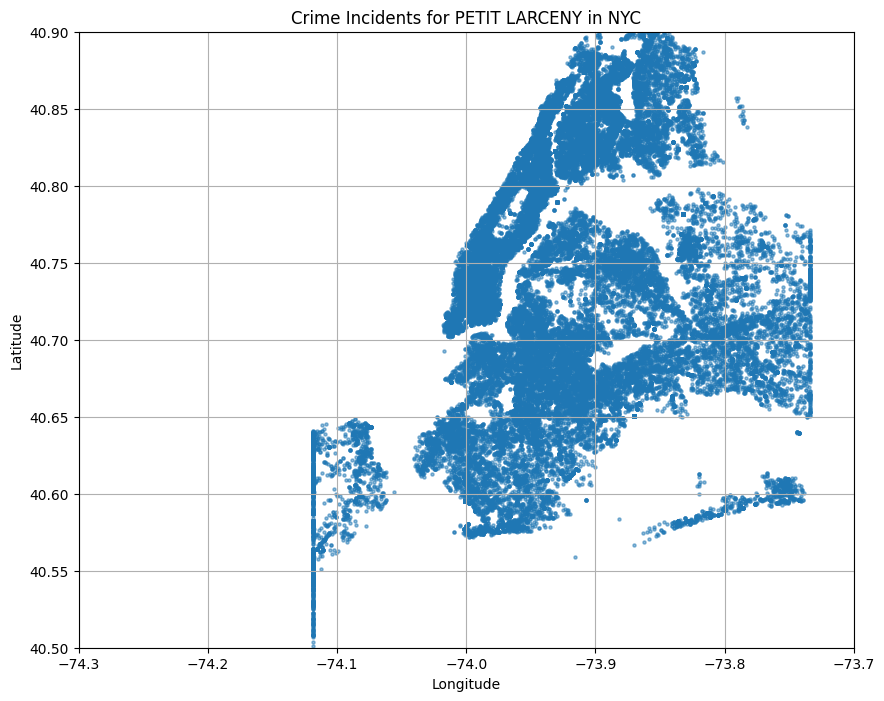

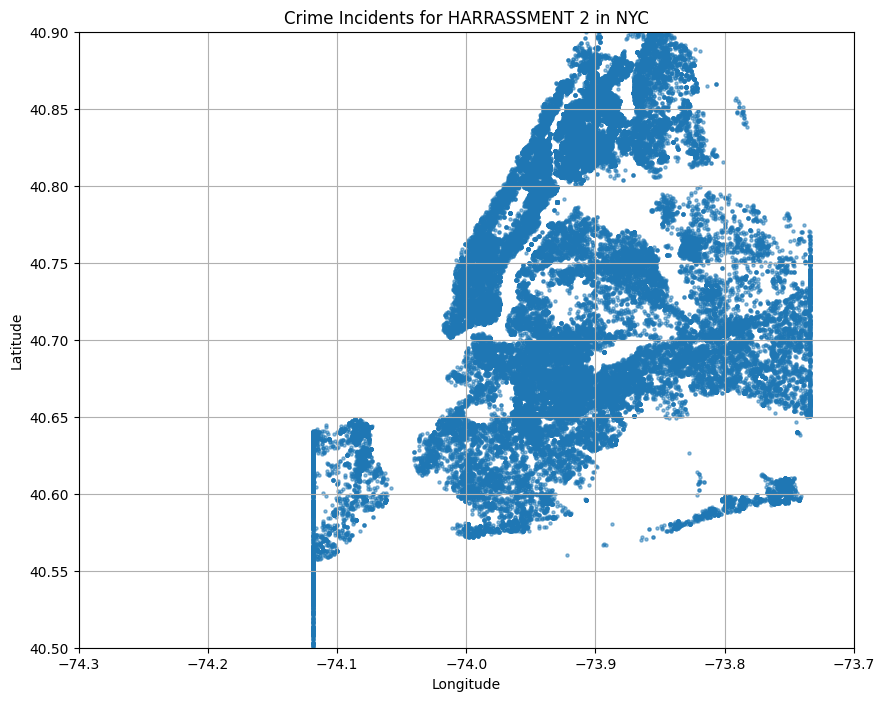

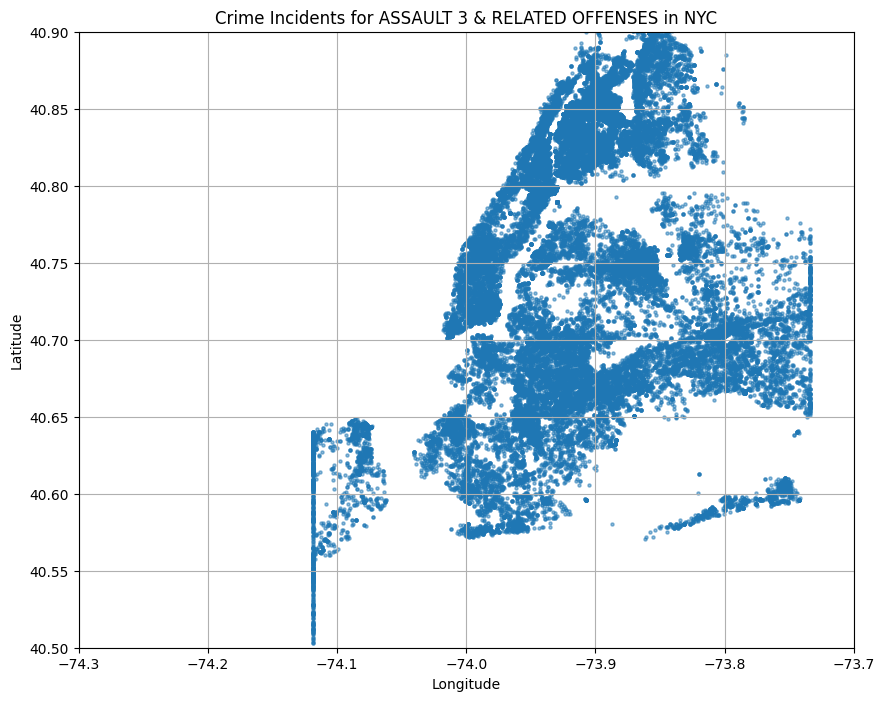

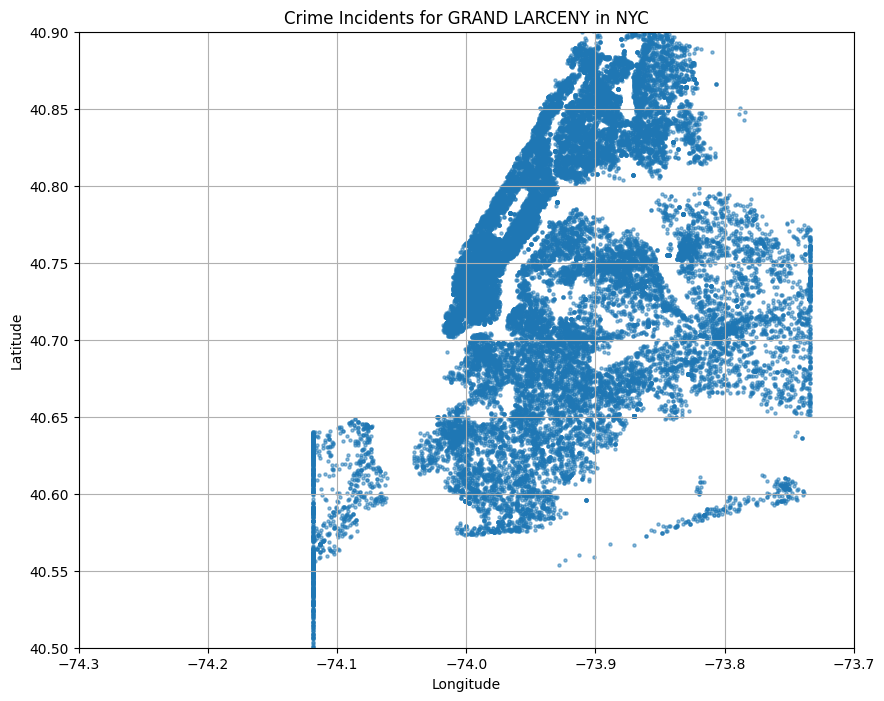

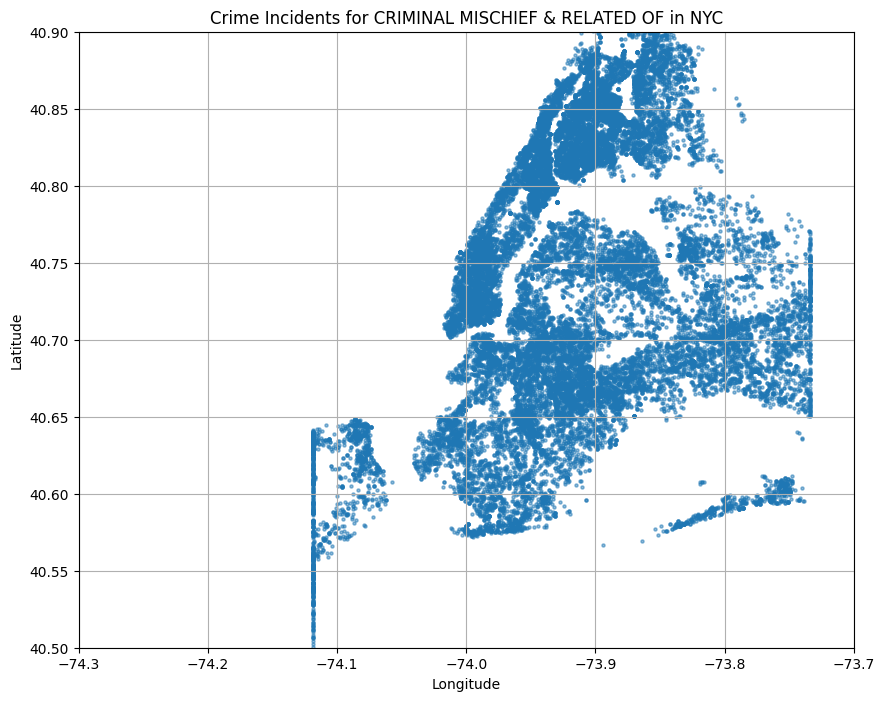

In [19]:
# # Convert offense descriptions to a list of unique offenses
# offense_types = data['OFNS_DESC'].unique()

# # Generate and display a separate map for each offense type
# for offense in offense_types:
#     # Filter the data for the current offense type
#     offense_data = data[data['OFNS_DESC'] == offense]

#     # Plotting the hotspots for the current offense type on a map of NYC
#     fig_offense_map = px.scatter_mapbox(offense_data, lat="Latitude", lon="Longitude",
#                                         hover_name="OFNS_DESC", hover_data=["BORO_NM", "LAW_CAT_CD"],
#                                         color_discrete_sequence=["blue"], zoom=10, height=600,
#                                         title=f"NYC Crime Hotspots for Offense: {offense}")

#     # Use an open-street map style
#     fig_offense_map.update_layout(mapbox_style="open-street-map")
#     fig_offense_map.show()
import matplotlib.pyplot as plt

# Get the top 5 most common offense types to map
top_offenses = data['OFNS_DESC'].value_counts().head(5).index

# Plot each offense type on a static map
for offense in top_offenses:
    # Filter data for the specific offense type
    offense_data = data[data['OFNS_DESC'] == offense]

    # Create a scatter plot for the offense type
    plt.figure(figsize=(10, 8))
    plt.scatter(offense_data['Longitude'], offense_data['Latitude'], alpha=0.5, s=5)
    plt.title(f"Crime Incidents for {offense} in NYC")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.xlim(-74.3, -73.7)  # Limits to focus on NYC area
    plt.ylim(40.5, 40.9)
    plt.grid(True)
    plt.show()


In [23]:
!pip install pandasql
import pandasql as ps

# calculate monthly distribution of crime incidents
query = """
SELECT
    strftime('%m', CMPLNT_FR_DT) AS Month,
    COUNT(*) AS Incident_Count
FROM
    data
GROUP BY
    Month
ORDER BY
    Month;
"""

# Execute the query to get monthly crime counts
monthly_crime_counts = ps.sqldf(query, locals())

# Plot the monthly distribution
fig = px.line(monthly_crime_counts, x='Month', y='Incident_Count',
              title="Monthly Distribution of Crime Incidents in NYC",
              labels={'Month': 'Month', 'Incident_Count': 'Number of Incidents'})

# Customize x-axis with month names
fig.update_xaxes(ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                           'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'],
                 tickvals=monthly_crime_counts['Month'])

fig.show()


  Preparing metadata (setup.py) ... done
  Created wheel for pandasql: filename=pandasql-0.7.3-py3-none-any.whl size=26772 sha256=ae02d0eb292f3c7003d8c17203469725fa89e0a91e58d00a4475656a9bcde5fe
  Stored in directory: /root/.cache/pip/wheels/e9/bc/3a/8434bdcccf5779e72894a9b24fecbdcaf97940607eaf4bcdf9
Successfully built pandasql


In [28]:
# Since we don't have a direct indicator for "arrested" and "escaped" in the dataset,
# we will use the "CRM_ATPT_CPTD_CD" column as a proxy.
# We'll assume "COMPLETED" may imply a successful crime (possibly with a suspect at large)
# and "ATTEMPTED" may imply the crime was disrupted (possibly with an escape or no completion).

# Importing necessary libraries
import pandas as pd
import plotly.express as px

borough_completion_status = data.groupby(['BORO_NM', 'CRM_ATPT_CPTD_CD']).size().reset_index(name='Incident_Count')

# Renaming columns for clarity
borough_completion_status.columns = ['Borough', 'Completion_Status', 'Incident_Count']

# Plotting the result
fig = px.bar(borough_completion_status, x='Borough', y='Incident_Count', color='Completion_Status',
             title="Crime Incidents by Completion Status for Each Borough",
             labels={'Borough': 'Borough', 'Incident_Count': 'Number of Incidents', 'Completion_Status': 'Crime Completion Status'},
             barmode='group')

fig.show()


In [24]:
# get crime completion status counts
query = """
SELECT
    CRM_ATPT_CPTD_CD AS Crime_Completion_Status,
    COUNT(*) AS Incident_Count
FROM
    data
GROUP BY
    Crime_Completion_Status
ORDER BY
    Incident_Count DESC;
"""

# Execute the query
crime_completion_status_counts = ps.sqldf(query, locals())

# Plotting
fig = px.bar(crime_completion_status_counts, x='Crime_Completion_Status', y='Incident_Count',
             title="Crime Incidents by Completion Status (Completed vs. Attempted)",
             labels={'Crime_Completion_Status': 'Crime Completion Status', 'Incident_Count': 'Number of Incidents'})
fig.show()

In [25]:
# get the top 10 premises types by incident count
query = """
SELECT
    PREM_TYP_DESC AS Premises_Type,
    COUNT(*) AS Incident_Count
FROM
    data
GROUP BY
    Premises_Type
ORDER BY
    Incident_Count DESC
LIMIT 10;
"""

# Execute the query
premises_type_counts = ps.sqldf(query, locals())

# Plotting
fig = px.bar(premises_type_counts, x='Premises_Type', y='Incident_Count',
             title="Top 10 Premises Types by Incident Count",
             labels={'Premises_Type': 'Premises Type', 'Incident_Count': 'Number of Incidents'})
fig.update_xaxes(tickangle=45)
fig.show()

In [26]:
# get hourly crime incident counts
query = """
SELECT
    strftime('%H', CMPLNT_FR_TM) AS Hour,
    COUNT(*) AS Incident_Count
FROM
    data
GROUP BY
    Hour
ORDER BY
    Hour;
"""

# Execute the query
hourly_incidents = ps.sqldf(query, locals())

# Plotting
fig = px.bar(hourly_incidents, x='Hour', y='Incident_Count',
             title="Crime Incidents by Hour of the Day",
             labels={'Hour': 'Hour of Day', 'Incident_Count': 'Number of Incidents'})
fig.show()

In [27]:
# get crime incident counts by hour
query = """
SELECT
    strftime('%H', CMPLNT_FR_TM) AS Hour,
    COUNT(*) AS Incident_Count
FROM
    data
GROUP BY
    Hour
ORDER BY
    Hour;
"""

# Execute the query
hourly_incidents = ps.sqldf(query, locals())

# Convert the hour from string to integer for categorization
hourly_incidents['Hour'] = hourly_incidents['Hour'].astype(int)

# Categorize as 'Day' or 'Night'
hourly_incidents['Time_of_Day'] = hourly_incidents['Hour'].apply(lambda x: 'Day' if 6 <= x < 18 else 'Night')

# Group by Time_of_Day and sum the incidents
time_of_day_counts = hourly_incidents.groupby('Time_of_Day')['Incident_Count'].sum().reset_index()

# Plotting
fig = px.bar(time_of_day_counts, x='Time_of_Day', y='Incident_Count',
             title="Crime Incidents by Time of Day (Day vs. Night)",
             labels={'Time_of_Day': 'Time of Day', 'Incident_Count': 'Number of Incidents'})
fig.show()